In [1]:
import random
import math

In [2]:
def G1():
    u = random.uniform(0,1)
    X = (-1/4)*math.log(u)
    return X

In [3]:
def G2():
    u = random.uniform(0,1)
    X = (-1/3)*math.log(u)
    return X

In [4]:
def arrival(lam =6, t =0):
    u = random.uniform(0,1)
    t = t - (1/lam)*math.log(u)
    return t

In [21]:
t = 0
n = 0
queue1, queue2 = [] , []
W1, W2 = 0,0
N_A = 0
c1, c2 =0,0
impossible = 10000000
t1,t2 = impossible, impossible
t_A = arrival()
A = {}
D = {}
T = 10
num1 = []
num2 = []
while(True):
    if min(t_A, t1,t2,T) == t_A:
        t = t_A
        N_A +=1
        t_A = arrival(t=t)
        A[N_A] = t
        if len(queue1) <= len(queue2):
            queue1.append(N_A)
            num1.append(N_A)
            if len(queue1) == 1:
                t1 = t + G1()
        else:
            queue2.append(N_A)
            num2.append(N_A)
            if len(queue1) == 1:
                t2 = t + G2()
    if min(t_A, t1, t2, T) == t1:
        t = t1
        c1+=1
        if queue1:
            W1 = queue1.pop(0)
        D[W1] = t
        if len(queue1) == 0:
            t1 = impossible
        else:
            W1 = queue1[0]
            t1 = t + G1()
    if min(t_A, t1, t2, T) == t2:
        t = t2
        c2 +=1
        if queue2:
            W2 = queue2.pop(0)
        D[W2] =t
        if len(queue2) == 0:
            t2 = impossible
        else:
            W2 = queue2[0]
            t2 = t + G2()
    if min(t_A, t1, t2, T) == T and (len(queue1) != 0 or len(queue2) != 0):
        if t1 == min(t1,t2):
            t = t1
            if queue1:
                W1 = queue1.pop(0)
            t1 = t + G1()
            D[W1] =t
        if t2 == min(t1,t2):
            t = t2
            if queue2:
                W2 = queue2.pop(0)
            t2 = t + G2()
            D[W2] =t
        if len(queue1) == 0 and len(queue2) ==0:
            break
            
        

In [27]:
Queue1_arrival = []
Queue1_departure  = []
for i in num1:
    Queue1_arrival.append(A[i])
    Queue1_departure.append(D[i])

In [29]:
Queue2_arrival =[]
Queue2_departure = []
for j in num2:
    Queue2_arrival.append(A[j])
    Queue2_departure.append(D[j])

In [10]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import pandas as pd
import numpy as np

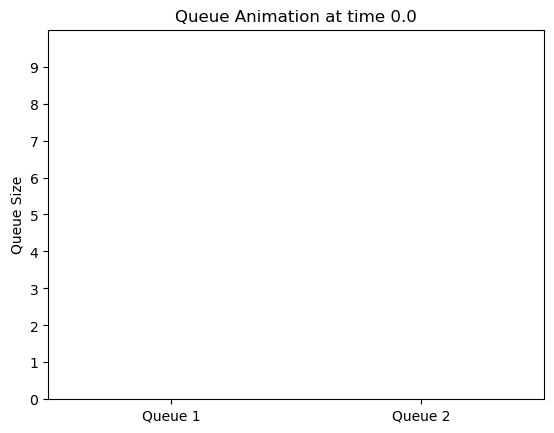

In [59]:
time  = np.linspace(0,11, 1000)
fig, ax = plt.subplots()
queuesize = {"Queue 1": 0,  "Queue 2":0}

def animate(i):
    q1_arrivals = np.sum(np.array(Queue1_arrival) <= time[i])
    q1_departures = np.sum(np.array(Queue1_departure) <= time[i])
    q2_arrivals = np.sum(np.array(Queue2_arrival) <= time[i])
    q2_departures = np.sum(np.array(Queue2_departure) <= time[i])
    
    ax.clear()
    queuesize["Queue 1"] = q1_arrivals - q1_departures
    queuesize["Queue 2"] = q2_arrivals - q2_departures
    queue_names = list(queuesize.keys())
    waiting = list(queuesize.values())
    ax.bar(queue_names, waiting)
    ax.set_ylim(0, 10)
    ax.set_yticks(range(0,10))
    ax.set_ylabel("Queue Size")
    ax.set_title(f"Queue Animation at time {round(time[i],1)}")

ani = animation.FuncAnimation(fig, animate, frames=len(time), interval=100, repeat=False)
from IPython.display import HTML
HTML(ani.to_jshtml())